In [2]:
import torch
import torchvision
import os
import json
import numpy as np
import mmcv
import mmdet
import matplotlib.pyplot as plt

from os.path import join
from os import listdir
from PIL import Image, ImageDraw
from random import sample
from mmdet.apis import inference_detector, init_detector, show_result_pyplot
from mmcv import Config
from mmdet.apis import set_random_seed
from mmdet.datasets import build_dataset
from mmdet.models import build_detector
from mmdet.apis import train_detector
from data.dataset import DeepFashion2
from configs.config_yolov3 import cfg

/home/danil/anaconda3/envs/nn/lib/python3.10/site-packages/mmcv/__init__.py:20: UserWarning: On January 1, 2023, MMCV will release v2.0.0, in which it will remove components related to the training process and add a data transformation module. In addition, it will rename the package names mmcv to mmcv-lite and mmcv-full to mmcv. See https://github.com/open-mmlab/mmcv/blob/master/docs/en/compatibility.md for more details.
  warnings.warn(


In [3]:
DEVICE = torch.device('cuda')

DEMO_PATH = 'demo'
CHECKPOINT_PATH = 'checkpoints/yolov3_d53_320_273e_coco-421362b6.pth'
CONFING_PATH = 'mmdetection/configs/yolo/yolov3_d53_320_273e_coco.py'

# See model

Download yolov3 weights

In [3]:
! python download_weights.py --weights yolov3_d53_320_273e_coco 

Founds weights: https://download.openmmlab.com/mmdetection/v2.0/yolo/yolov3_d53_320_273e_coco/yolov3_d53_320_273e_coco-421362b6.pth

File already present


In [4]:
model_yolov3 = init_detector(CONFING_PATH, CHECKPOINT_PATH, device=DEVICE)

load checkpoint from local path: checkpoints/yolov3_d53_320_273e_coco-421362b6.pth


/home/danil/projects/fashion_detection/mmdetection/mmdet/datasets/utils.py:66: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(


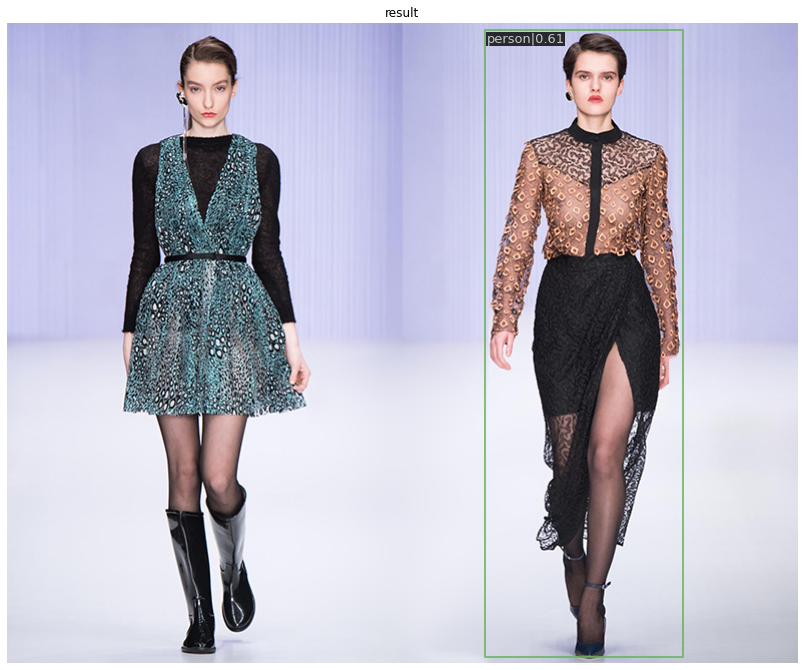

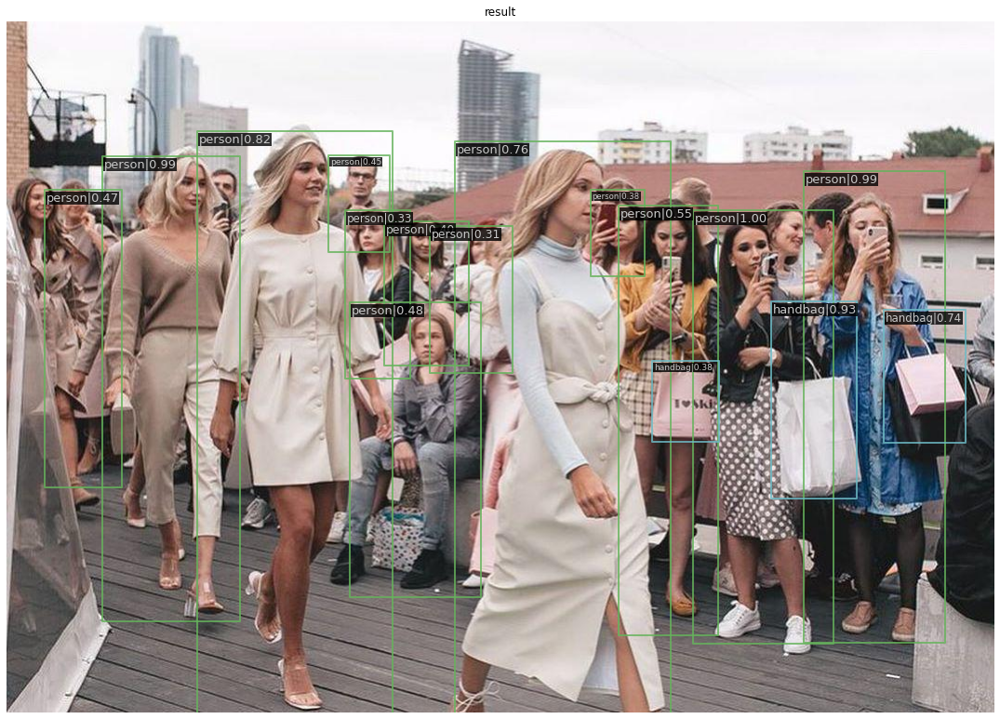

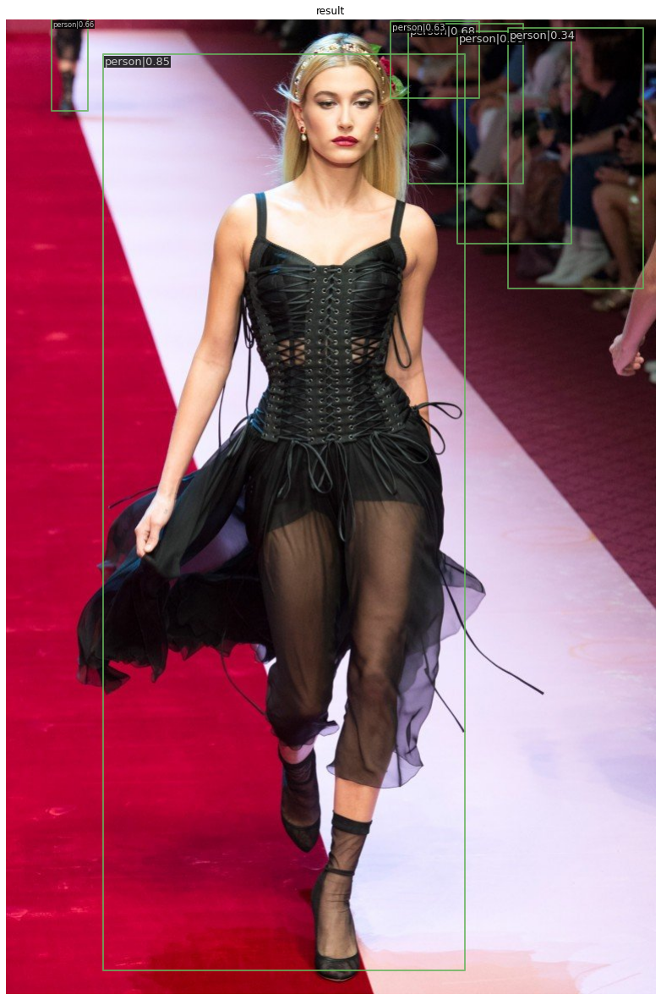

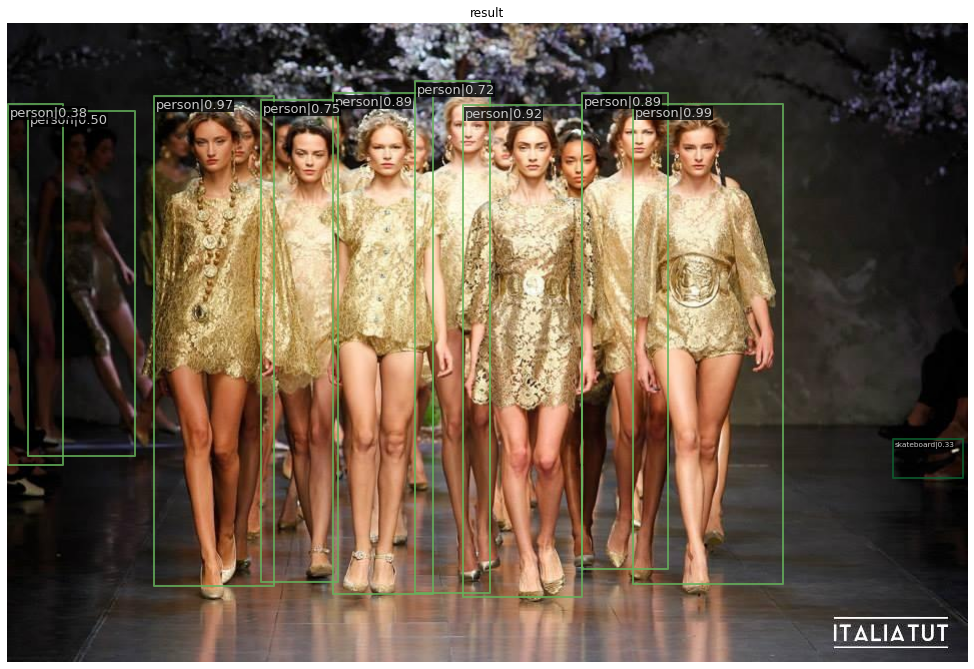

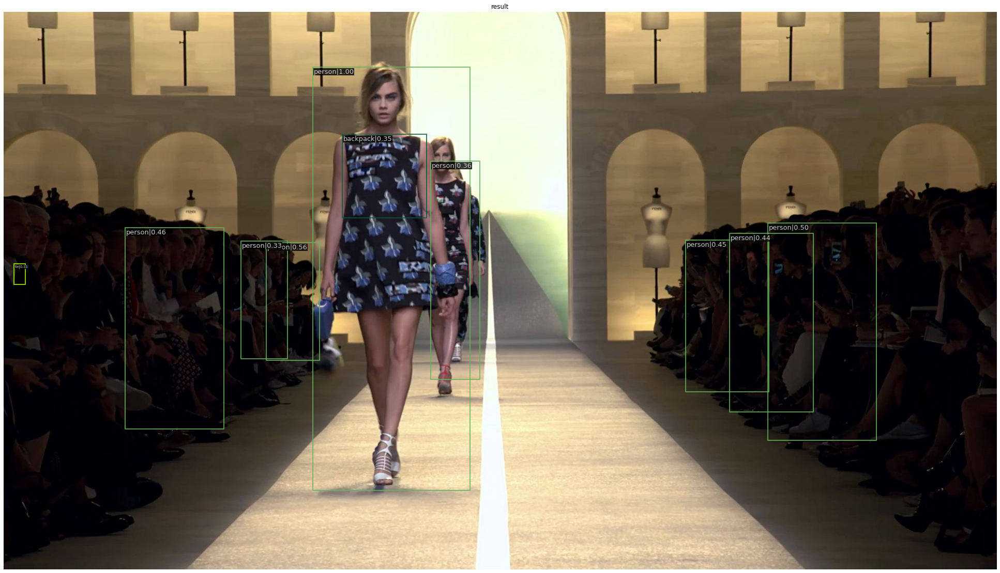

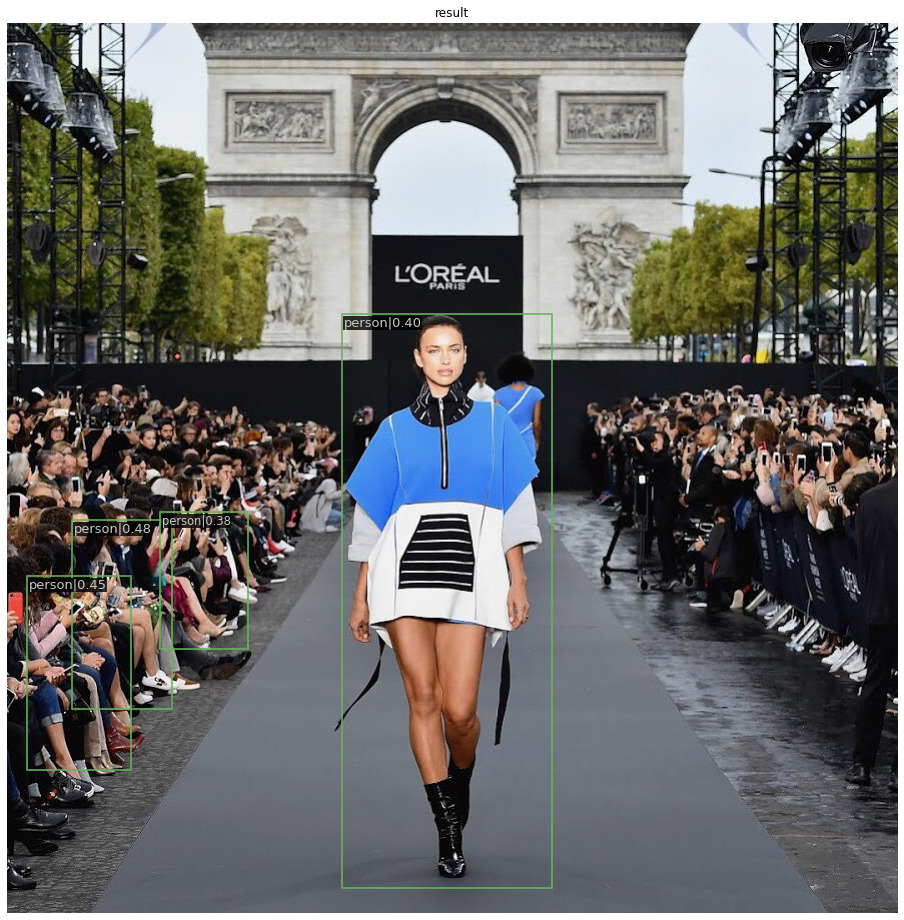

In [6]:
imgs = listdir('demo/demo_images')

for img in imgs:
    if img.split('.')[1] in ['jpg', 'jpeg', 'png']:
        img = mmcv.imread(join('demo/demo_images/', img))
        result = inference_detector(model_yolov3, img)
        show_result_pyplot(model_yolov3, img, result, score_thr=0.3)

Our model does not see any clothes, but see some person. It may help to highlight features to your fine-tuning model.

In [ ]:
datasets = [build_dataset(cfg.data.train)]

Build our dataset

In [6]:
datasets[0]


DeepFashion2 Train dataset with number of images 191961, and instance counts: 
+------------------------+-------+---------------------+-------+--------------------------+-------+-------------------------+-------+------------------------+-------+
| category               | count | category            | count | category                 | count | category                | count | category               | count |
+------------------------+-------+---------------------+-------+--------------------------+-------+-------------------------+-------+------------------------+-------+
| 0 [short sleeve top]   | 53193 | 1 [long sleeve top] | 24598 | 2 [short sleeve outwear] | 428   | 3 [long sleeve outwear] | 11000 | 4 [vest]               | 12699 |
| 5 [sling]              | 1604  | 6 [shorts]          | 11941 | 7 [trousers]             | 24015 | 8 [skirt]               | 7286  | 9 [short sleeve dress] | 16693 |
|                        |       |                     |       |                     

In [7]:
model = build_detector(cfg.model)
model.CLASSES = datasets[0].CLASSES

mmcv.mkdir_or_exist(cfg.work_dir)

In [8]:
train_detector(model, datasets, cfg, distributed=False, validate=True)

2023-01-21 09:22:01,527 - mmdet - INFO - Automatic scaling of learning rate (LR) has been disabled.
2023-01-21 09:26:34,796 - mmdet - INFO - load checkpoint from local path: checkpoints/yolov3_d53_320_273e_coco-421362b6.pth
2023-01-21 09:26:34,928 - mmdet - WARNING - The model and loaded state dict do not match exactly

size mismatch for bbox_head.convs_pred.0.weight: copying a param with shape torch.Size([255, 1024, 1, 1]) from checkpoint, the shape in current model is torch.Size([54, 1024, 1, 1]).
size mismatch for bbox_head.convs_pred.0.bias: copying a param with shape torch.Size([255]) from checkpoint, the shape in current model is torch.Size([54]).
size mismatch for bbox_head.convs_pred.1.weight: copying a param with shape torch.Size([255, 512, 1, 1]) from checkpoint, the shape in current model is torch.Size([54, 512, 1, 1]).
size mismatch for bbox_head.convs_pred.1.bias: copying a param with shape torch.Size([255]) from checkpoint, the shape in current model is torch.Size([54]).


[>>>>>>>>>>>>>>>>>>>>>>>>] 32153/32153, 64.6 task/s, elapsed: 498s, ETA:     0s
---------------iou_thr: 0.5---------------


2023-01-21 11:08:49,379 - mmdet - INFO - 
+----------------------+------+-------+--------+-------+
| class                | gts  | dets  | recall | ap    |
+----------------------+------+-------+--------+-------+
| short sleeve top     | 9466 | 37294 | 0.989  | 0.767 |
| long sleeve top      | 4253 | 26860 | 0.960  | 0.508 |
| short sleeve outwear | 105  | 705   | 0.219  | 0.017 |
| long sleeve outwear  | 1662 | 17462 | 0.966  | 0.519 |
| vest                 | 1736 | 21504 | 0.969  | 0.499 |
| sling                | 270  | 7999  | 0.711  | 0.055 |
| shorts               | 1201 | 23051 | 0.978  | 0.552 |
| trousers             | 3057 | 22998 | 0.953  | 0.594 |
| skirt                | 2098 | 25943 | 0.960  | 0.490 |
| short sleeve dress   | 3023 | 26778 | 0.979  | 0.558 |
| long sleeve dress    | 1401 | 16538 | 0.924  | 0.349 |
| vest dress           | 2980 | 24852 | 0.984  | 0.639 |
| sling dress          | 717  | 21963 | 0.964  | 0.119 |
+----------------------+------+-------+-------

[>>>>>>>>>>>>>>>>>>>>>>>>] 32153/32153, 67.6 task/s, elapsed: 476s, ETA:     0s
---------------iou_thr: 0.5---------------


2023-01-21 12:50:15,353 - mmdet - INFO - 
+----------------------+------+-------+--------+-------+
| class                | gts  | dets  | recall | ap    |
+----------------------+------+-------+--------+-------+
| short sleeve top     | 9466 | 33630 | 0.989  | 0.810 |
| long sleeve top      | 4253 | 25112 | 0.971  | 0.551 |
| short sleeve outwear | 105  | 196   | 0.048  | 0.006 |
| long sleeve outwear  | 1662 | 13897 | 0.960  | 0.606 |
| vest                 | 1736 | 14622 | 0.942  | 0.580 |
| sling                | 270  | 6360  | 0.719  | 0.099 |
| shorts               | 1201 | 18000 | 0.959  | 0.501 |
| trousers             | 3057 | 28338 | 0.959  | 0.591 |
| skirt                | 2098 | 17280 | 0.921  | 0.496 |
| short sleeve dress   | 3023 | 20081 | 0.976  | 0.567 |
| long sleeve dress    | 1401 | 14964 | 0.949  | 0.395 |
| vest dress           | 2980 | 14769 | 0.943  | 0.695 |
| sling dress          | 717  | 11548 | 0.863  | 0.212 |
+----------------------+------+-------+-------

[>>>>>>>>>>>>>>>>>>>>>>>>] 32153/32153, 67.9 task/s, elapsed: 474s, ETA:     0s
---------------iou_thr: 0.5---------------


2023-01-21 14:33:12,539 - mmdet - INFO - 
+----------------------+------+-------+--------+-------+
| class                | gts  | dets  | recall | ap    |
+----------------------+------+-------+--------+-------+
| short sleeve top     | 9466 | 33114 | 0.992  | 0.822 |
| long sleeve top      | 4253 | 22260 | 0.971  | 0.597 |
| short sleeve outwear | 105  | 930   | 0.333  | 0.042 |
| long sleeve outwear  | 1662 | 12379 | 0.969  | 0.657 |
| vest                 | 1736 | 13571 | 0.956  | 0.624 |
| sling                | 270  | 6301  | 0.778  | 0.201 |
| shorts               | 1201 | 22850 | 0.976  | 0.455 |
| trousers             | 3057 | 25568 | 0.979  | 0.673 |
| skirt                | 2098 | 21697 | 0.925  | 0.439 |
| short sleeve dress   | 3023 | 18948 | 0.973  | 0.653 |
| long sleeve dress    | 1401 | 11616 | 0.925  | 0.456 |
| vest dress           | 2980 | 13595 | 0.960  | 0.730 |
| sling dress          | 717  | 9640  | 0.869  | 0.244 |
+----------------------+------+-------+-------

[>>>>>>>>>>>>>>>>>>>>>>>>] 32153/32153, 65.3 task/s, elapsed: 492s, ETA:     0s
---------------iou_thr: 0.5---------------


2023-01-21 16:13:21,718 - mmdet - INFO - 
+----------------------+------+-------+--------+-------+
| class                | gts  | dets  | recall | ap    |
+----------------------+------+-------+--------+-------+
| short sleeve top     | 9466 | 29228 | 0.987  | 0.818 |
| long sleeve top      | 4253 | 17044 | 0.941  | 0.599 |
| short sleeve outwear | 105  | 651   | 0.229  | 0.047 |
| long sleeve outwear  | 1662 | 12934 | 0.971  | 0.653 |
| vest                 | 1736 | 21250 | 0.976  | 0.570 |
| sling                | 270  | 8523  | 0.841  | 0.336 |
| shorts               | 1201 | 23066 | 0.987  | 0.615 |
| trousers             | 3057 | 20002 | 0.972  | 0.667 |
| skirt                | 2098 | 24236 | 0.965  | 0.532 |
| short sleeve dress   | 3023 | 16490 | 0.956  | 0.665 |
| long sleeve dress    | 1401 | 8775  | 0.882  | 0.444 |
| vest dress           | 2980 | 18977 | 0.985  | 0.726 |
| sling dress          | 717  | 11964 | 0.872  | 0.292 |
+----------------------+------+-------+-------

[>>>>>>>>>>>>>>>>>>>>>>>>] 32153/32153, 64.3 task/s, elapsed: 500s, ETA:     0s
---------------iou_thr: 0.5---------------


2023-01-21 17:54:58,909 - mmdet - INFO - 
+----------------------+------+-------+--------+-------+
| class                | gts  | dets  | recall | ap    |
+----------------------+------+-------+--------+-------+
| short sleeve top     | 9466 | 34833 | 0.990  | 0.814 |
| long sleeve top      | 4253 | 22272 | 0.973  | 0.610 |
| short sleeve outwear | 105  | 244   | 0.238  | 0.063 |
| long sleeve outwear  | 1662 | 11956 | 0.977  | 0.665 |
| vest                 | 1736 | 17133 | 0.963  | 0.650 |
| sling                | 270  | 5276  | 0.822  | 0.326 |
| shorts               | 1201 | 20815 | 0.973  | 0.613 |
| trousers             | 3057 | 25063 | 0.972  | 0.669 |
| skirt                | 2098 | 22197 | 0.958  | 0.540 |
| short sleeve dress   | 3023 | 20305 | 0.977  | 0.655 |
| long sleeve dress    | 1401 | 12769 | 0.951  | 0.450 |
| vest dress           | 2980 | 18628 | 0.985  | 0.725 |
| sling dress          | 717  | 11945 | 0.884  | 0.282 |
+----------------------+------+-------+-------

[>>>>>>>>>>>>>>>>>>>>>>>>] 32153/32153, 65.1 task/s, elapsed: 494s, ETA:     0s
---------------iou_thr: 0.5---------------


2023-01-21 19:36:17,622 - mmdet - INFO - 
+----------------------+------+-------+--------+-------+
| class                | gts  | dets  | recall | ap    |
+----------------------+------+-------+--------+-------+
| short sleeve top     | 9466 | 29633 | 0.985  | 0.834 |
| long sleeve top      | 4253 | 23917 | 0.976  | 0.599 |
| short sleeve outwear | 105  | 352   | 0.267  | 0.055 |
| long sleeve outwear  | 1662 | 10099 | 0.949  | 0.660 |
| vest                 | 1736 | 14595 | 0.968  | 0.633 |
| sling                | 270  | 4551  | 0.789  | 0.350 |
| shorts               | 1201 | 15196 | 0.966  | 0.637 |
| trousers             | 3057 | 24897 | 0.976  | 0.656 |
| skirt                | 2098 | 24639 | 0.974  | 0.562 |
| short sleeve dress   | 3023 | 17529 | 0.958  | 0.701 |
| long sleeve dress    | 1401 | 13020 | 0.941  | 0.441 |
| vest dress           | 2980 | 16707 | 0.974  | 0.751 |
| sling dress          | 717  | 8646  | 0.874  | 0.328 |
+----------------------+------+-------+-------

[>>>>>>>>>>>>>>>>>>>>>>>>] 32153/32153, 65.2 task/s, elapsed: 493s, ETA:     0s
---------------iou_thr: 0.5---------------


2023-01-21 21:18:25,555 - mmdet - INFO - 
+----------------------+------+-------+--------+-------+
| class                | gts  | dets  | recall | ap    |
+----------------------+------+-------+--------+-------+
| short sleeve top     | 9466 | 30316 | 0.992  | 0.839 |
| long sleeve top      | 4253 | 21745 | 0.981  | 0.616 |
| short sleeve outwear | 105  | 663   | 0.371  | 0.066 |
| long sleeve outwear  | 1662 | 9427  | 0.961  | 0.691 |
| vest                 | 1736 | 12956 | 0.963  | 0.659 |
| sling                | 270  | 3573  | 0.800  | 0.309 |
| shorts               | 1201 | 17046 | 0.970  | 0.595 |
| trousers             | 3057 | 22838 | 0.979  | 0.689 |
| skirt                | 2098 | 15213 | 0.926  | 0.528 |
| short sleeve dress   | 3023 | 14744 | 0.951  | 0.705 |
| long sleeve dress    | 1401 | 9137  | 0.900  | 0.455 |
| vest dress           | 2980 | 12619 | 0.957  | 0.772 |
| sling dress          | 717  | 7666  | 0.845  | 0.319 |
+----------------------+------+-------+-------

[>>>>>>>>>>>>>>>>>>>>>>>>] 32153/32153, 63.2 task/s, elapsed: 509s, ETA:     0s
---------------iou_thr: 0.5---------------


2023-01-21 23:03:26,738 - mmdet - INFO - 
+----------------------+------+-------+--------+-------+
| class                | gts  | dets  | recall | ap    |
+----------------------+------+-------+--------+-------+
| short sleeve top     | 9466 | 29941 | 0.990  | 0.841 |
| long sleeve top      | 4253 | 22166 | 0.976  | 0.636 |
| short sleeve outwear | 105  | 487   | 0.352  | 0.100 |
| long sleeve outwear  | 1662 | 10073 | 0.974  | 0.700 |
| vest                 | 1736 | 15908 | 0.964  | 0.660 |
| sling                | 270  | 2446  | 0.752  | 0.400 |
| shorts               | 1201 | 14381 | 0.961  | 0.591 |
| trousers             | 3057 | 24178 | 0.980  | 0.685 |
| skirt                | 2098 | 21023 | 0.968  | 0.544 |
| short sleeve dress   | 3023 | 17550 | 0.974  | 0.682 |
| long sleeve dress    | 1401 | 12456 | 0.950  | 0.460 |
| vest dress           | 2980 | 16923 | 0.975  | 0.764 |
| sling dress          | 717  | 9957  | 0.863  | 0.355 |
+----------------------+------+-------+-------

[>>>>>>>>>>>>>>>>>>>>>>>>] 32153/32153, 65.3 task/s, elapsed: 493s, ETA:     0s
---------------iou_thr: 0.5---------------


2023-01-22 00:46:41,624 - mmdet - INFO - 
+----------------------+------+-------+--------+-------+
| class                | gts  | dets  | recall | ap    |
+----------------------+------+-------+--------+-------+
| short sleeve top     | 9466 | 30019 | 0.993  | 0.846 |
| long sleeve top      | 4253 | 18260 | 0.972  | 0.643 |
| short sleeve outwear | 105  | 587   | 0.543  | 0.123 |
| long sleeve outwear  | 1662 | 8420  | 0.968  | 0.705 |
| vest                 | 1736 | 12961 | 0.953  | 0.686 |
| sling                | 270  | 3561  | 0.804  | 0.413 |
| shorts               | 1201 | 13818 | 0.972  | 0.661 |
| trousers             | 3057 | 17809 | 0.977  | 0.679 |
| skirt                | 2098 | 17676 | 0.951  | 0.569 |
| short sleeve dress   | 3023 | 15820 | 0.966  | 0.716 |
| long sleeve dress    | 1401 | 9092  | 0.914  | 0.478 |
| vest dress           | 2980 | 14417 | 0.966  | 0.776 |
| sling dress          | 717  | 7065  | 0.858  | 0.372 |
+----------------------+------+-------+-------

[>>>>>>>>>>>>>>>>>>>>>>>>] 32153/32153, 65.1 task/s, elapsed: 494s, ETA:     0s
---------------iou_thr: 0.5---------------


2023-01-22 02:30:50,126 - mmdet - INFO - 
+----------------------+------+-------+--------+-------+
| class                | gts  | dets  | recall | ap    |
+----------------------+------+-------+--------+-------+
| short sleeve top     | 9466 | 28076 | 0.983  | 0.834 |
| long sleeve top      | 4253 | 26680 | 0.989  | 0.618 |
| short sleeve outwear | 105  | 119   | 0.105  | 0.021 |
| long sleeve outwear  | 1662 | 12948 | 0.976  | 0.651 |
| vest                 | 1736 | 11039 | 0.950  | 0.674 |
| sling                | 270  | 3108  | 0.774  | 0.415 |
| shorts               | 1201 | 15592 | 0.974  | 0.613 |
| trousers             | 3057 | 25679 | 0.980  | 0.660 |
| skirt                | 2098 | 17807 | 0.946  | 0.544 |
| short sleeve dress   | 3023 | 14312 | 0.961  | 0.702 |
| long sleeve dress    | 1401 | 11477 | 0.931  | 0.488 |
| vest dress           | 2980 | 12553 | 0.955  | 0.786 |
| sling dress          | 717  | 7160  | 0.852  | 0.370 |
+----------------------+------+-------+-------

10 epoch - mAP - 0.56

Not bad

# Inference model

In [7]:
model = init_detector(cfg, 'outputs/yolov3_d53_320_273e_coco/latest.pth', device=DEVICE)

load checkpoint from local path: outputs/yolov3_d53_320_273e_coco/latest.pth


## Train data

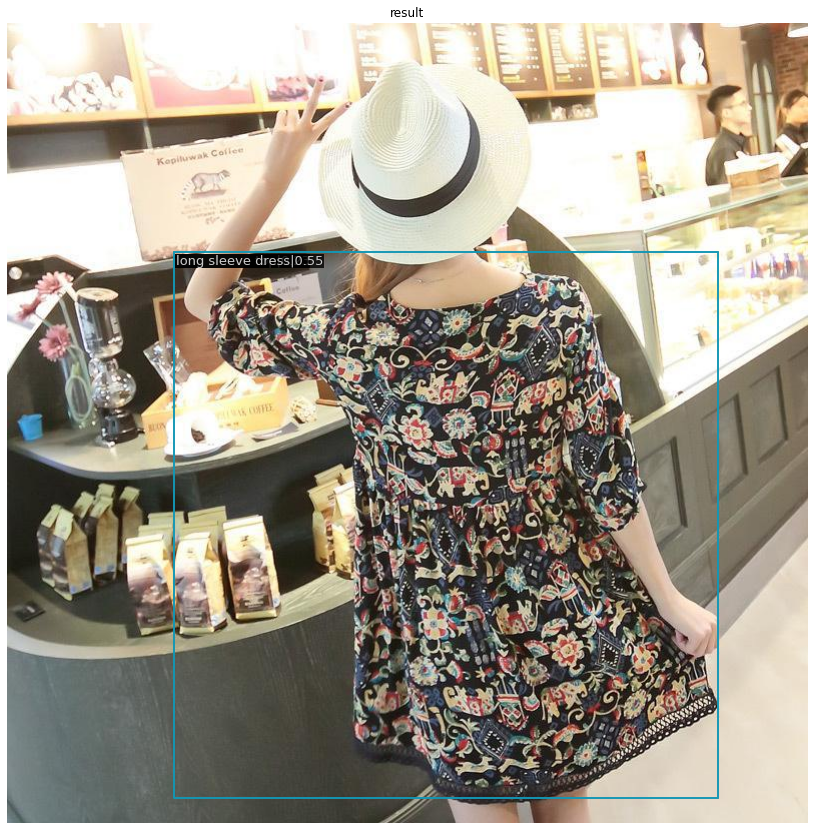

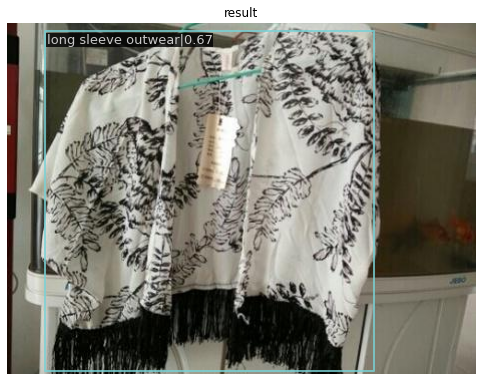

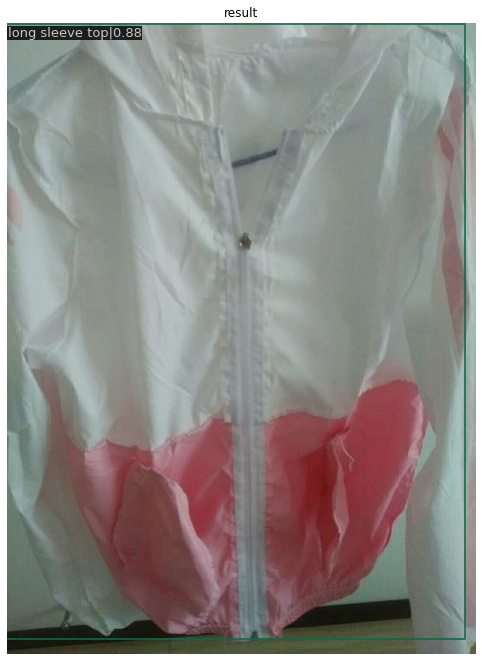

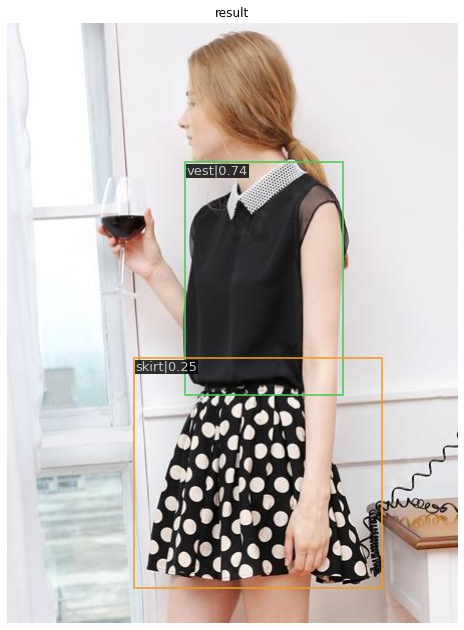

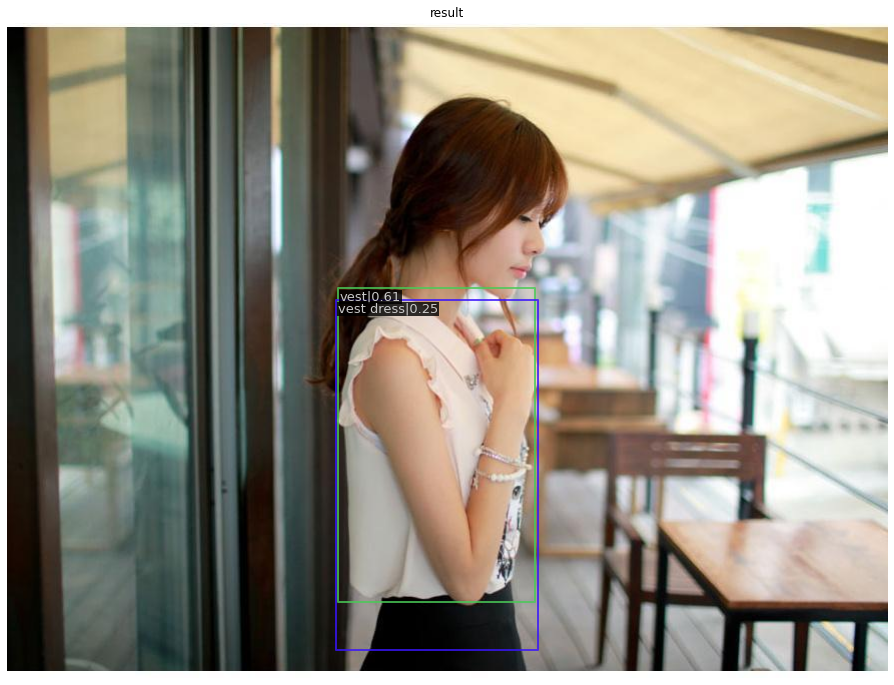

In [8]:
imgs = sample(os.listdir('data/train/image/'), 5)

for img in imgs:
    img = mmcv.imread(join('data/train/image/', img))
    result = inference_detector(model, img)
    show_result_pyplot(model, img, result, score_thr=0.2)

## Validation data

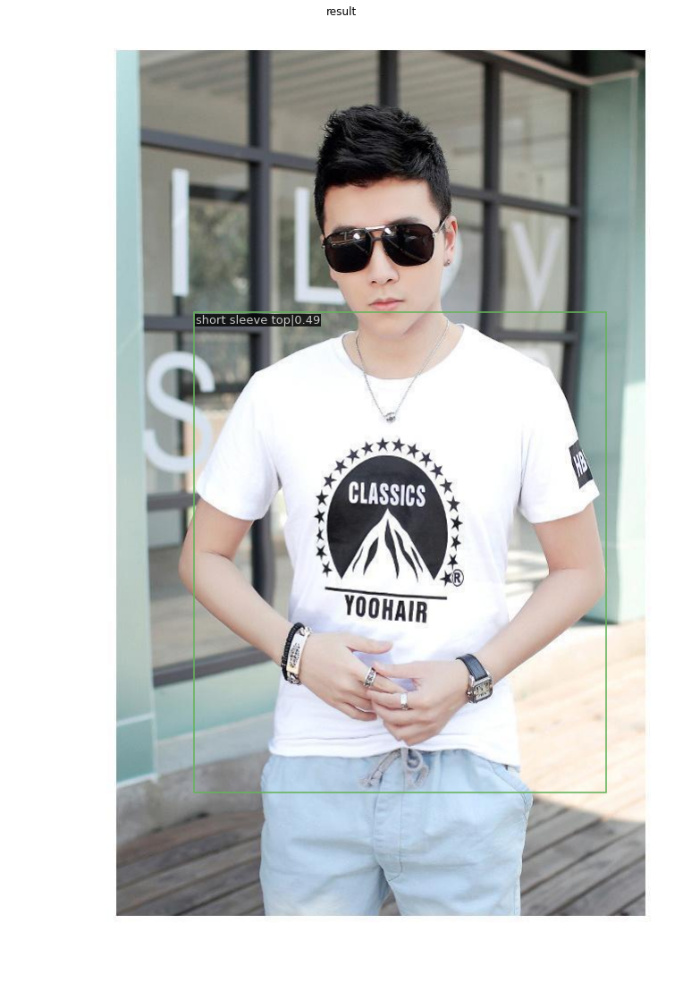

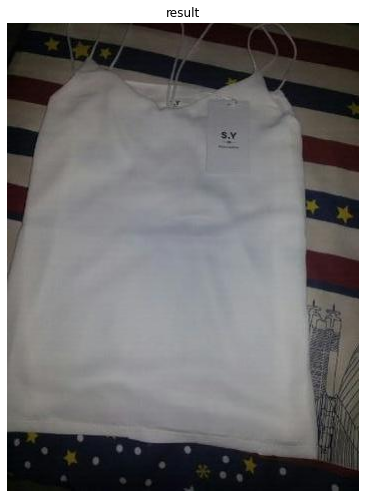

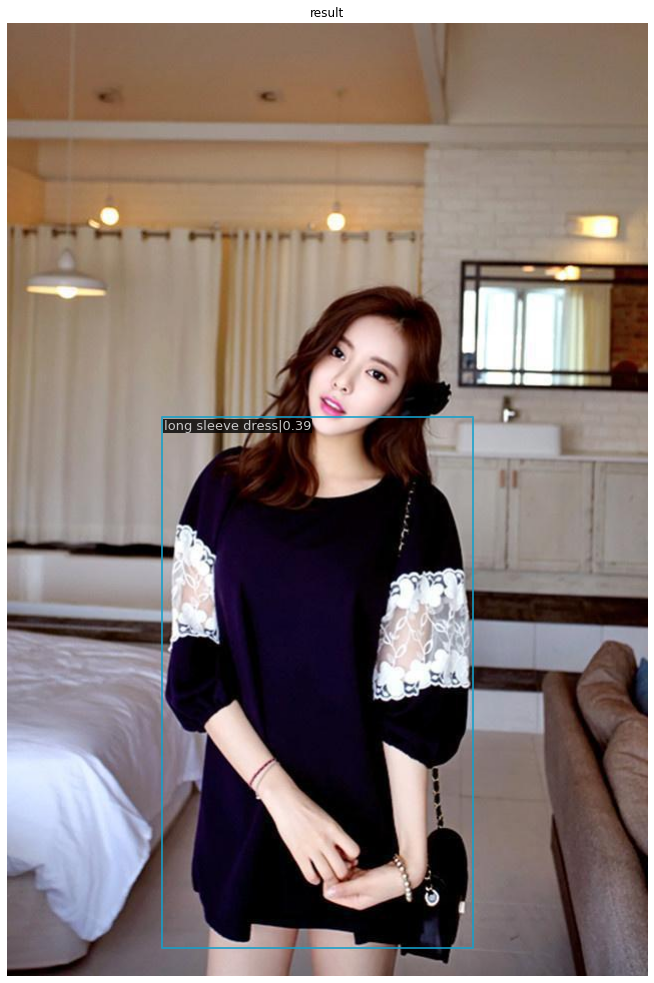

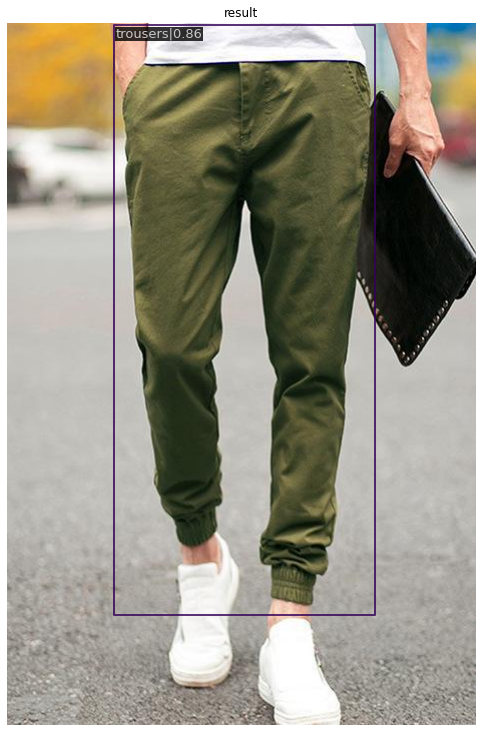

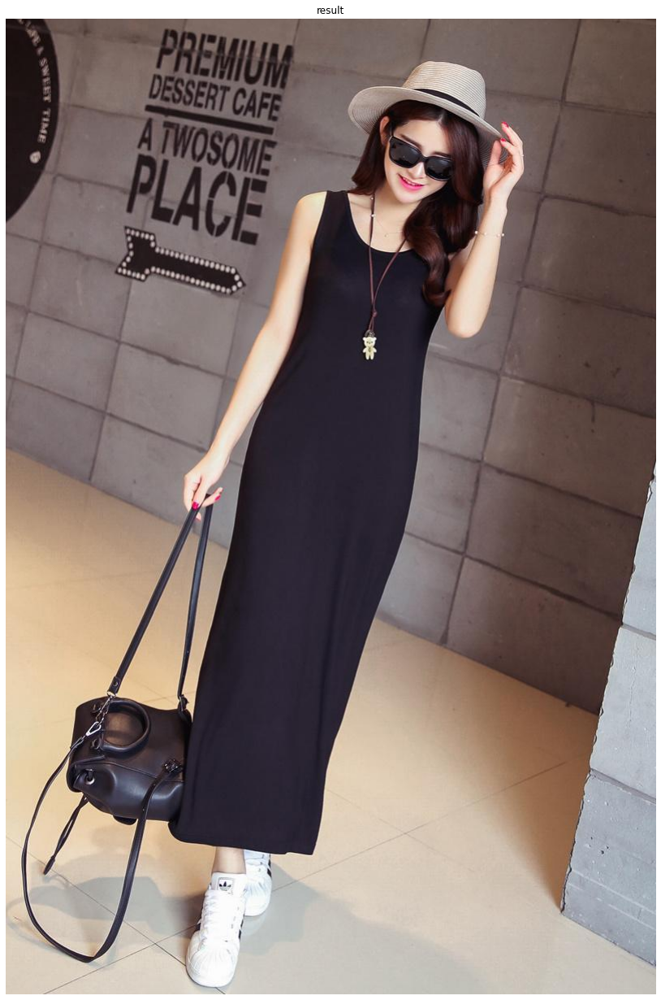

In [9]:
imgs = sample(os.listdir('data/validation/image/'), 5)

for img in imgs:
    img = mmcv.imread(join('data/validation/image/', img))
    result = inference_detector(model, img)
    show_result_pyplot(model, img, result, score_thr=0.3)

## Demo images

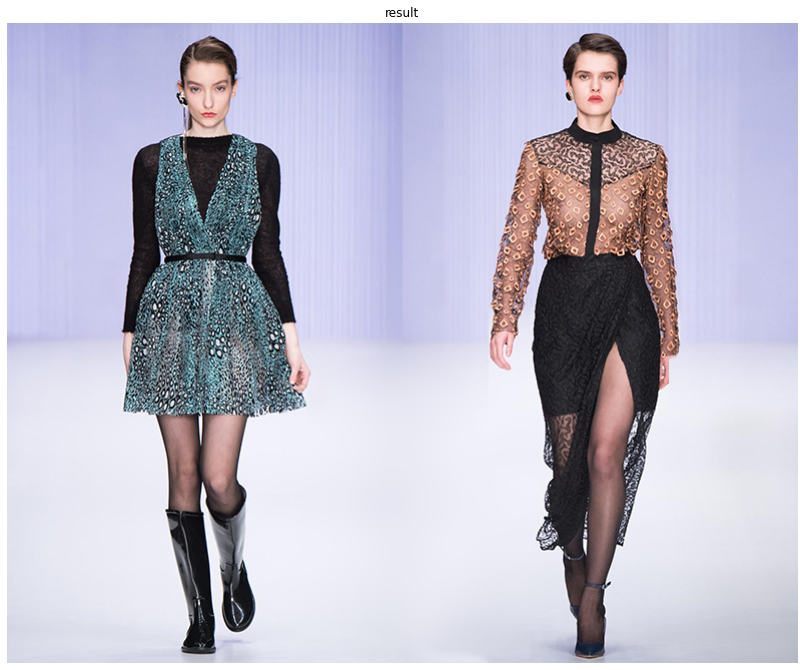

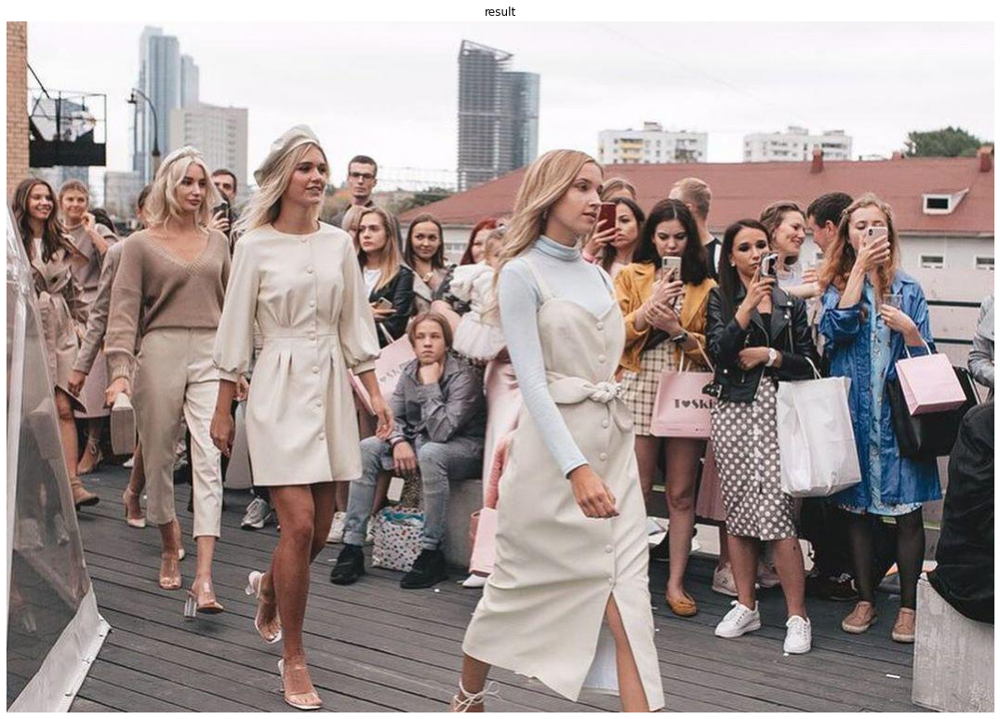

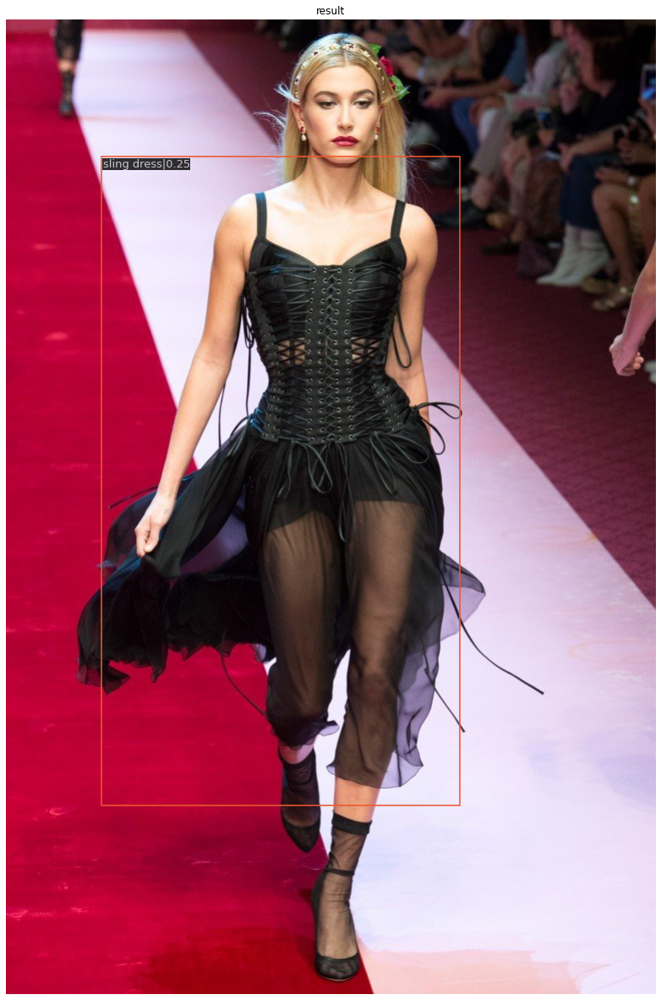

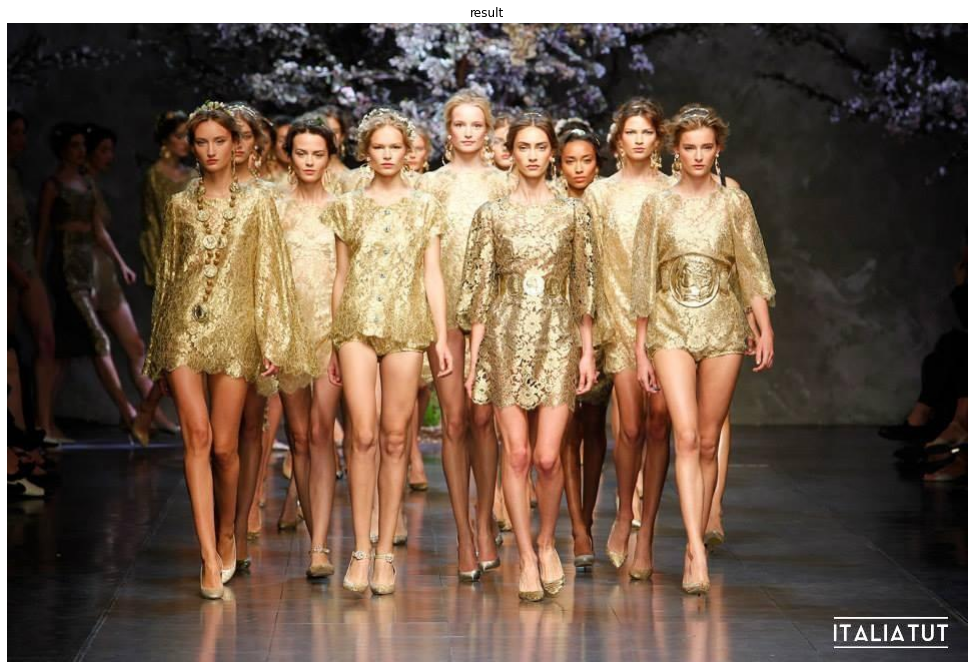

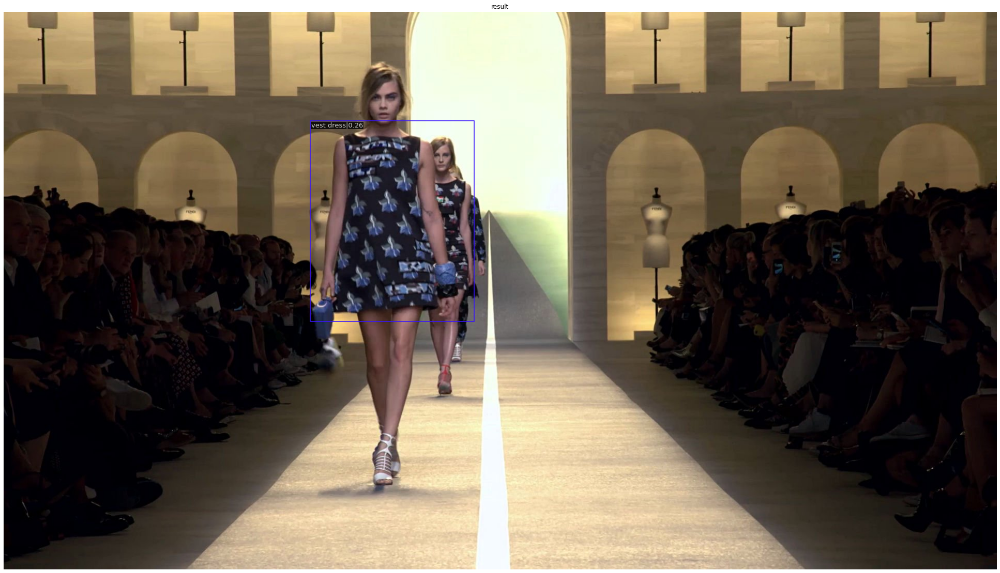

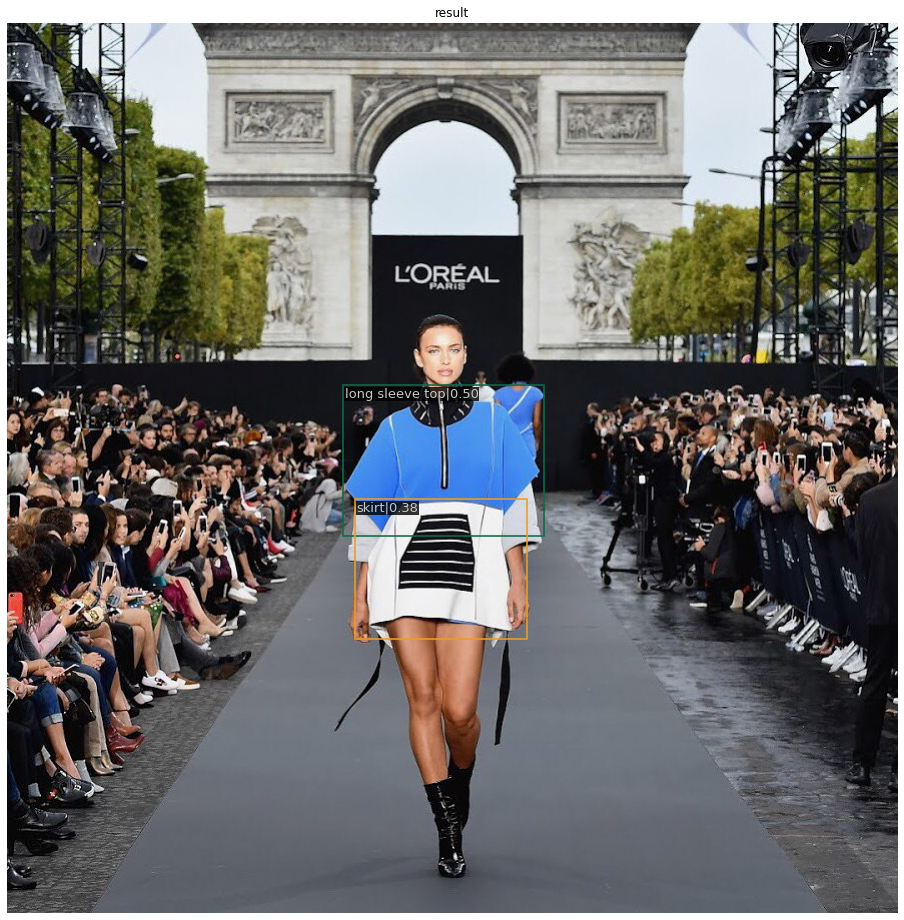

In [11]:
imgs = listdir('demo/demo_images')

for img in imgs:
    if img.split('.')[1] in ['jpg', 'jpeg', 'png']:
        img = mmcv.imread(join('demo/demo_images/', img))
        result = inference_detector(model, img)
        show_result_pyplot(model, img, result, score_thr=0.2)

YOLO trained for 10 epochs in 16 hours, reaching a MAP metric of 0.56. YOLO is as always fast and accurate. The only bad thing is that the model does not see all the clothes in the demo images. I also saw that both models do not see clothes, provided that there is a large 1 person in the frame or it is located far away.

It seems to me that if you retrain the models, you will get a better result.

As for the applications of models, they can be applied in the fashion industry. When moths pass in front of the camera, automatically detect pieces of clothing and then classify firms with a different model.

It can also be used to collect statistics in various supermarkets / shops / public places.

This model can also be used to check images inside reviews. When a person leaves a review with a picture, it is necessary to check whether the product in the image is the right one. To do this, we find the clothes from the review in the image using our detection model + another one to evaluate the similarity. This will help large clothing stores check reviews of their products quickly.